# Rain tests
`docker pull namo626/adg-tacc:rain`

Mass conservation from rain source term works correctly when everything is wet. A problem is encountered when everything starts out as dry, because ADCIRC has no wetting criteria solely for mass source term [[report](https://adcirc.org/wp-content/uploads/sites/2255/2018/11/1999_Luettich01.pdf)]. Therefore we add an additional wetting criteria as follows in `wetdry.F`:

```fortran
where (eta2 + dp > 1.1*h0)
    nnodecode = 1
end where
```

In [1]:
from utils_beach import *
from IPython.display import HTML
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

%matplotlib inline
%load_ext autoreload
%autoreload 2

## Still-water bathtub

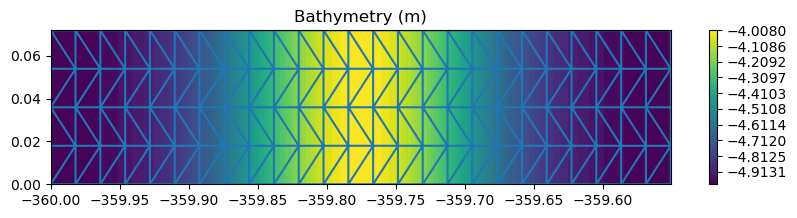

<Figure size 640x480 with 0 Axes>

In [4]:
fig = plot_bathy('Tub/fort.14', figsize=(10,2), plot_grid=True)

We run the case with 0.5 rain per hour for 1 day.

    adcirc-dg --solver 1 --rain 1 --rain_days 1
    

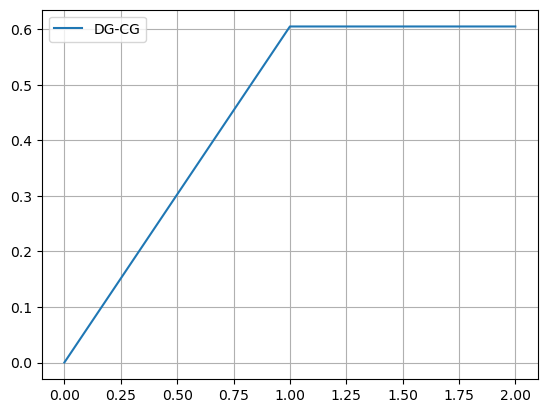

<Figure size 640x480 with 0 Axes>

In [5]:
t1, e1 = getStation('Tub/fort.61',1)

f = plt.figure()
plt.plot(t1, e1, label='DG-CG')
plt.grid()
plt.legend()
plt.show()
plt.clf()

## Still-water bathtub initially dry

Here we raise the above test case to be initially dry. We expect the whole domain to become eventually wet from the rain. If not, then there are problems with the wet/dry approach.

<Figure size 640x480 with 0 Axes>

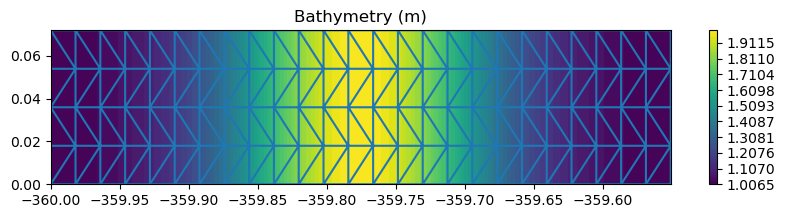

<Figure size 640x480 with 0 Axes>

In [2]:
fig = plot_bathy('Tub_dry/fort.14', figsize=(10,2), plot_grid=True)

Run with

    adcirc-dg --solver 1 --rain 1

In [4]:
tr, d2 = read_63_all('Tub_dry/fort.63', 'Tub_dry/fort.14')
data = [
        ('DG-CG, 0.5 inch rain / hour', d2)
]

ani = animate_mesh(tr, data, plot_grid=True, plot_contour=False, vmin=0, vmax=3, frameskip=20,extent=None, figsize=(10,2))
HTML(ani.to_jshtml())

## Wet/dry subdomain from 120m mesh
The extent is [-94.7,-94.5; 29.4,29.6)

<Figure size 640x480 with 0 Axes>

<Figure size 1000x200 with 0 Axes>

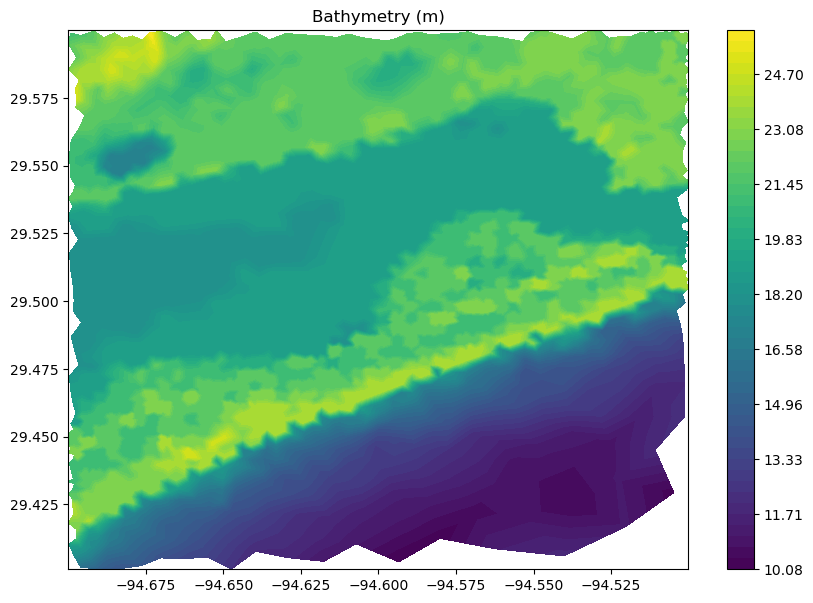

In [10]:
f = plot_bathy('still_rain/fort.14')

In [2]:
tr, d5 = read_63_all('still_rain/fort.63', 'still_rain/fort.14')


In [6]:

data = [
        ('DG-CG, 0.5 inch rain / hour', d5)
]

ani = animate_mesh(tr, data, plot_grid=False, vmin=-2, vmax=30, frameskip=1,extent=None)

HTML(ani.to_jshtml())


## Cut from 120m mesh

In [29]:
tr, d2 = read_63_all('ike_rain/fort.63.wind', 'ike_rain/fort.14')

data = [
        #('ADCIRC', d1), 
        ('DG-CG, 0.5 inch rain / hour', d2)
]


In [32]:
ani = animate_mesh(tr, data, plot_grid=False, vmin=-2, vmax=20, frameskip=5)
HTML(ani.to_jshtml())

<Figure size 640x480 with 0 Axes>

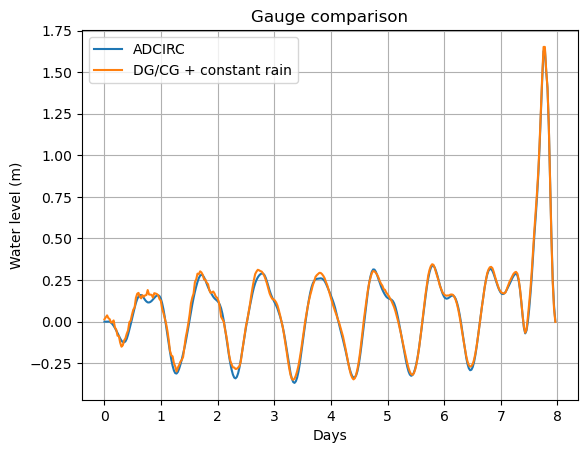

In [12]:
st = 52
ps = [
    ('ike_small/fort.61.adc', 'ADCIRC'),
    ('ike_rain/fort.61.wind', 'DG/CG + constant rain')
]
f = plot_station(st, ps)

## Parametric rain (Harvey)
Here we run Harvey with `NWS=20` on the same mesh as above, using the R-CLIPER parametric rain model. Run with

    mpirun --np <procs> padcirc-dg --solver 1 --rain 2

In [26]:
tr, d2 = read_63_all('harvey/fort.63.rain', 'harvey/fort.14')

In [33]:
tr, d1 = read_63_all('harvey/fort.63', 'harvey/fort.14')

In [36]:
data = [
        ('DG-CG', d1),
        ('DG-CG + R-CLIPER', d2)
]
ani = animate_mesh(tr, data, plot_grid=False, vmin=-2, vmax=20, frameskip=10)
HTML(ani.to_jshtml())

<Figure size 640x480 with 0 Axes>

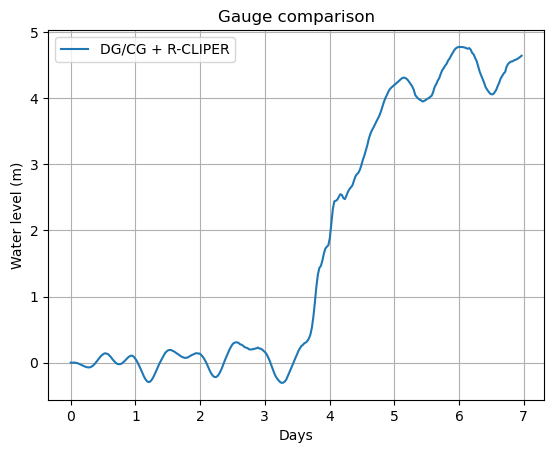

In [17]:
st = 52
ps = [
    ('harvey/fort.61.rain', 'DG/CG + R-CLIPER')
]
f = plot_station(st, ps)